# Install required module

In [ ]:
!pip install asyncpraw

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.7/196.7 kB 3.6 MB/s eta 0:00:00
  Using cached update_checker-0.18.0-py3-none-any.whl (7.0 kB)


# Scrape Data from Reddit

In [ ]:
import asyncpraw
import pandas as pd

In [ ]:
user_agent = 'WAD/0.0.1 by u/toto_thii'
reddit = asyncpraw.Reddit(
    client_id="lWhLT7Kf1WP6AqVO4ZDjNw",
    client_secret="UbGj_MWj_3WKSPglOR0JXGMPoY9JZg",
    user_agent=user_agent,
)

In [ ]:
async def get_reddit_data(subreddit):
    subreddit = await reddit.subreddit(subreddit)
    data = set()
    async for submission in subreddit.new(limit=None):
        result = (submission.id, submission.title, submission.author, submission.score, submission.ups, submission.downs, submission.upvote_ratio, submission.subreddit, submission.created_utc, submission.permalink)

        if result not in data:
            data.add(result)

    columns = ['id', 'title', 'author', 'score', 'upvote', 'downvote', 'upvote_ratio', 'subreddit', 'created_at', 'url']
    df = pd.DataFrame(data, columns=columns)

    return df

async def scrape_reddit_data(subreddits):
    dataframes = []

    for sub_name in subreddits:
        df = await get_reddit_data(sub_name)
        dataframes.append(df)

    return dataframes

In [ ]:
import asyncio

sub_reddit = ['conservation', 'Wildlife', 'EndangeredSpecies', 'AnimalRights', 'invasivespecies', 'wildlifebiology']
data = set()
loop = asyncio.get_event_loop()

if loop.is_running():
    loop = asyncio.get_running_loop()

result_df = await scrape_reddit_data(sub_reddit)

merged_data = pd.concat(result_df, ignore_index=True)

In [ ]:
merged_data

,id,title,author,score,upvote,downvote,upvote_ratio,subreddit,created_at,url
0,146k8si,EPA sued over pesticide-coated seeds’ ‘devasta...,DaRedGuy,83,83,0,1.00,conservation,1.686457e+09,/r/conservation/comments/146k8si/epa_sued_over...
1,131cqs2,Researchers explore techniques to successfully...,kjleebio,4,4,0,0.76,conservation,1.682642e+09,/r/conservation/comments/131cqs2/researchers_e...
2,12z7pao,Online appeal launched to help Welsh seagrass ...,kjleebio,7,7,0,1.00,conservation,1.682487e+09,/r/conservation/comments/12z7pao/online_appeal...
3,12z7az3,Vodacom South Africa and WWF recommit to ocean...,kjleebio,1,1,0,1.00,conservation,1.682486e+09,/r/conservation/comments/12z7az3/vodacom_south...
4,11qzwha,'New kind of park': Ecological wonderland plan...,kjleebio,8,8,0,1.00,conservation,1.678780e+09,/r/conservation/comments/11qzwha/new_kind_of_p...
...,...,...,...,...,...,...,...,...,...,...
5789,pm34qx,Illegal wildlife trade posing ecological threa...,environmentind,4,4,0,1.00,wildlifebiology,1.631346e+09,/r/wildlifebiology/comments/pm34qx/illegal_wil...
5790,16rxhhr,Survey on Taxonomy in Wildlife Biology,fishfacedmf,1,1,0,1.00,wildlifebiology,1.695661e+09,/r/wildlifebiology/comments/16rxhhr/survey_on_...
5791,tqpqt1,kind of related masters?,coffinpoppies,5,5,0,0.86,wildlifebiology,1.648521e+09,/r/wildlifebiology/comments/tqpqt1/kind_of_rel...
5792,16z4thb,Job Market,HallowedSeeker,6,6,0,0.88,wildlifebiology,1.696370e+09,/r/wildlifebiology/comments/16z4thb/job_market/


In [ ]:
merged_data.to_csv('wildlife_conservation.csv', index=False)

# Exploratory Data Analysis

In [175]:
import pandas as pd

temp_df = pd.read_csv('wildlife_conservation.csv')

In [176]:
temp_df

,id,title,author,score,upvote,downvote,upvote_ratio,subreddit,created_at,url
0,146k8si,EPA sued over pesticide-coated seeds’ ‘devasta...,DaRedGuy,83,83,0,1.00,conservation,1.686457e+09,/r/conservation/comments/146k8si/epa_sued_over...
1,131cqs2,Researchers explore techniques to successfully...,kjleebio,4,4,0,0.76,conservation,1.682642e+09,/r/conservation/comments/131cqs2/researchers_e...
2,12z7pao,Online appeal launched to help Welsh seagrass ...,kjleebio,7,7,0,1.00,conservation,1.682487e+09,/r/conservation/comments/12z7pao/online_appeal...
3,12z7az3,Vodacom South Africa and WWF recommit to ocean...,kjleebio,1,1,0,1.00,conservation,1.682486e+09,/r/conservation/comments/12z7az3/vodacom_south...
4,11qzwha,'New kind of park': Ecological wonderland plan...,kjleebio,8,8,0,1.00,conservation,1.678780e+09,/r/conservation/comments/11qzwha/new_kind_of_p...
...,...,...,...,...,...,...,...,...,...,...
5789,pm34qx,Illegal wildlife trade posing ecological threa...,environmentind,4,4,0,1.00,wildlifebiology,1.631346e+09,/r/wildlifebiology/comments/pm34qx/illegal_wil...
5790,16rxhhr,Survey on Taxonomy in Wildlife Biology,fishfacedmf,1,1,0,1.00,wildlifebiology,1.695661e+09,/r/wildlifebiology/comments/16rxhhr/survey_on_...
5791,tqpqt1,kind of related masters?,coffinpoppies,5,5,0,0.86,wildlifebiology,1.648521e+09,/r/wildlifebiology/comments/tqpqt1/kind_of_rel...
5792,16z4thb,Job Market,HallowedSeeker,6,6,0,0.88,wildlifebiology,1.696370e+09,/r/wildlifebiology/comments/16z4thb/job_market/


In [177]:
temp_df.duplicated().sum()

0

In [178]:
temp_df.isna().sum()

id                0
title             0
author          123
score             0
upvote            0
downvote          0
upvote_ratio      0
subreddit         0
created_at        0
url               0
dtype: int64

In [179]:
df = temp_df.dropna()

In [180]:
df.isna().sum()

id              0
title           0
author          0
score           0
upvote          0
downvote        0
upvote_ratio    0
subreddit       0
created_at      0
url             0
dtype: int64

In [181]:
df.dtypes

id               object
title            object
author           object
score             int64
upvote            int64
downvote          int64
upvote_ratio    float64
subreddit        object
created_at      float64
url              object
dtype: object

In [182]:
df['created_at'] = pd.to_datetime(df['created_at'], unit='s')

<ipython-input-182-4f97c2db88d6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['created_at'] = pd.to_datetime(df['created_at'], unit='s')


In [183]:
df['created_at']

0      2023-06-11 04:20:38
1      2023-04-28 00:41:32
2      2023-04-26 05:35:04
3      2023-04-26 05:15:04
4      2023-03-14 07:40:20
               ...        
5789   2021-09-11 07:46:21
5790   2023-09-25 16:56:56
5791   2022-03-29 02:35:11
5792   2023-10-03 21:56:26
5793   2021-08-20 17:45:38
Name: created_at, Length: 5671, dtype: datetime64[ns]

In [184]:
summary_stats = df[['upvote','downvote', 'score', 'upvote_ratio']].describe()
summary_stats

,upvote,downvote,score,upvote_ratio
count,5671.000000,5671.0,5671.000000,5671.000000
mean,18.900723,0.0,18.900723,0.923721
std,43.249420,0.0,43.249420,0.116827
min,0.000000,0.0,0.000000,0.130000
25%,3.000000,0.0,3.000000,0.890000
50%,9.000000,0.0,9.000000,0.970000
75%,22.000000,0.0,22.000000,1.000000
max,1608.000000,0.0,1608.000000,1.000000


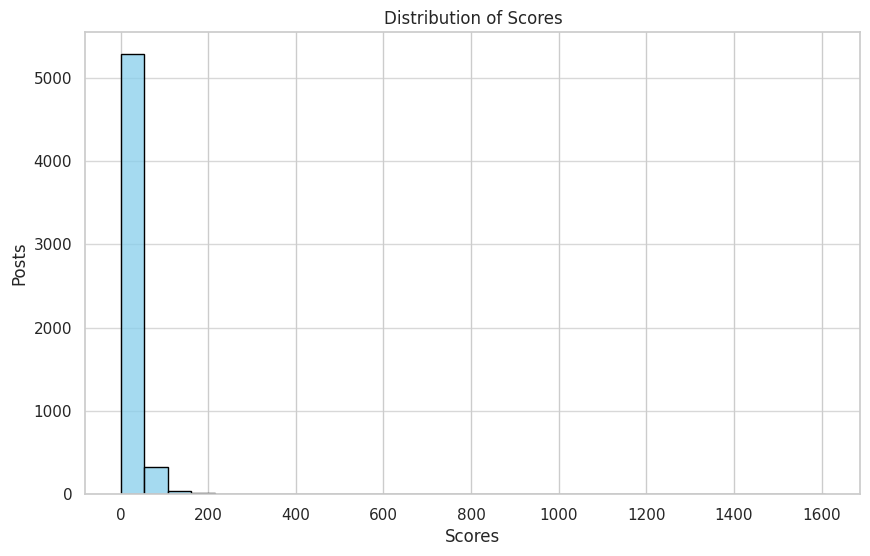

In [185]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plotting the histogram using Seaborn
plt.figure(figsize=(10, 6))
sns.histplot(df['score'], bins=30, color='skyblue', edgecolor='black', kde=False)  # kde=False for histogram only
plt.title('Distribution of Scores')
plt.xlabel('Scores')
plt.ylabel('Posts')
plt.grid(axis='y', alpha=0.75)

# Show the plot
plt.show()

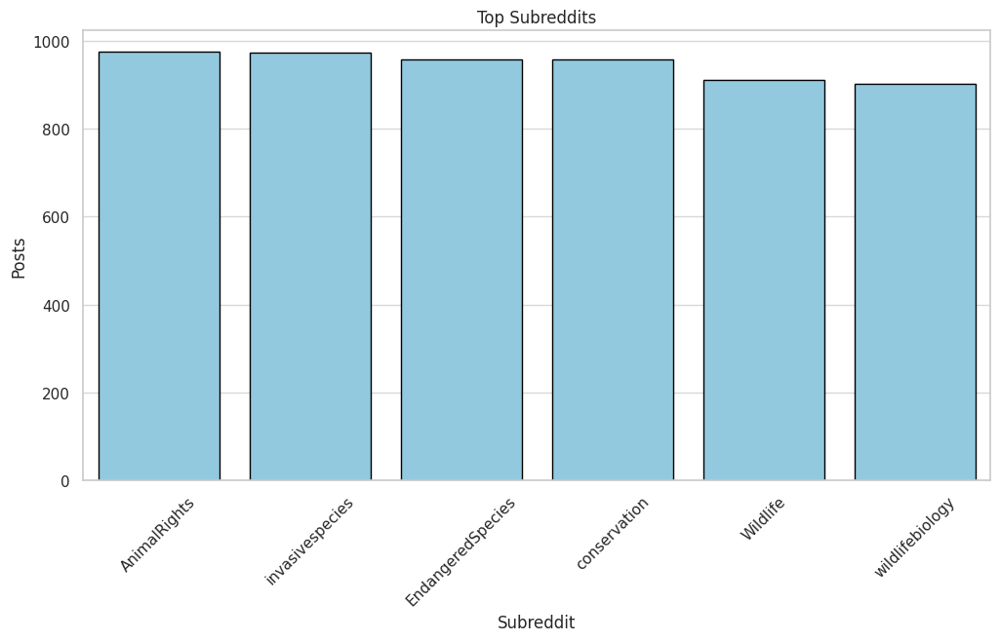

In [186]:
#Top subreddit from all subreddits
top_subreddits = df['subreddit'].value_counts().nlargest(10)

# Plotting the bar chart using Seaborn
plt.figure(figsize=(12, 6))
sns.barplot(x=top_subreddits.index, y=top_subreddits.values, color='skyblue', edgecolor='black')
plt.title('Top Subreddits')
plt.xlabel('Subreddit')
plt.ylabel('Posts')
plt.xticks(rotation=45)
plt.grid(axis='y', alpha=0.75)

# Show the plot
plt.show()

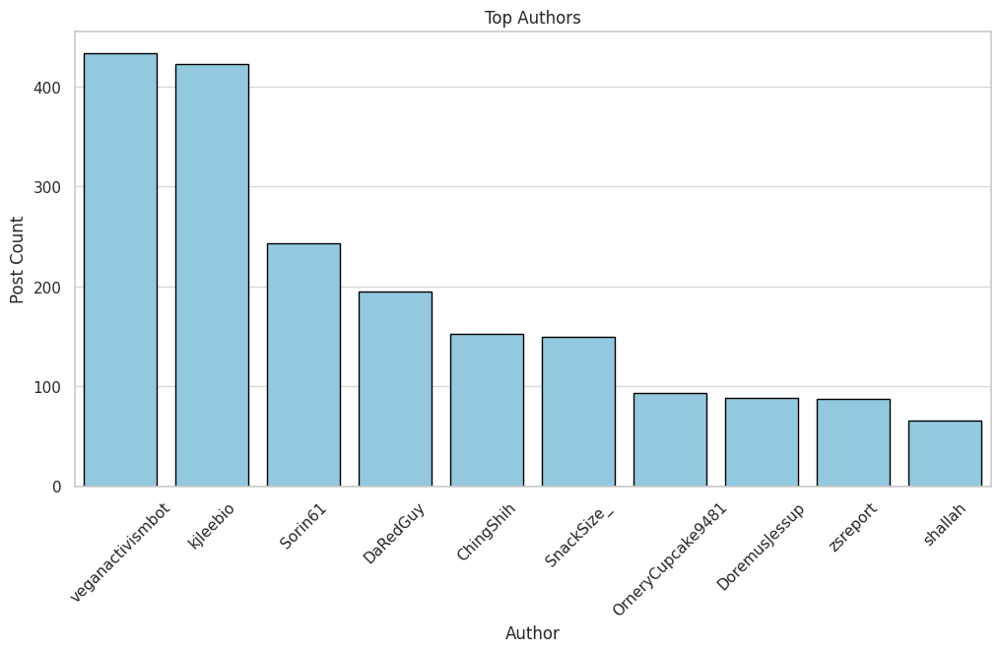

In [187]:
# Top author from our dataset by posts count
top_authors = df['author'].value_counts().nlargest(10)

plt.figure(figsize=(12, 6))
sns.barplot(x=top_authors.index, y=top_authors.values, color='skyblue', edgecolor='black')
plt.title('Top Authors')
plt.xlabel('Author')
plt.ylabel('Post Count')
plt.xticks(rotation=45)
plt.grid(axis='y', alpha=0.75)

# Show the plot
plt.show()

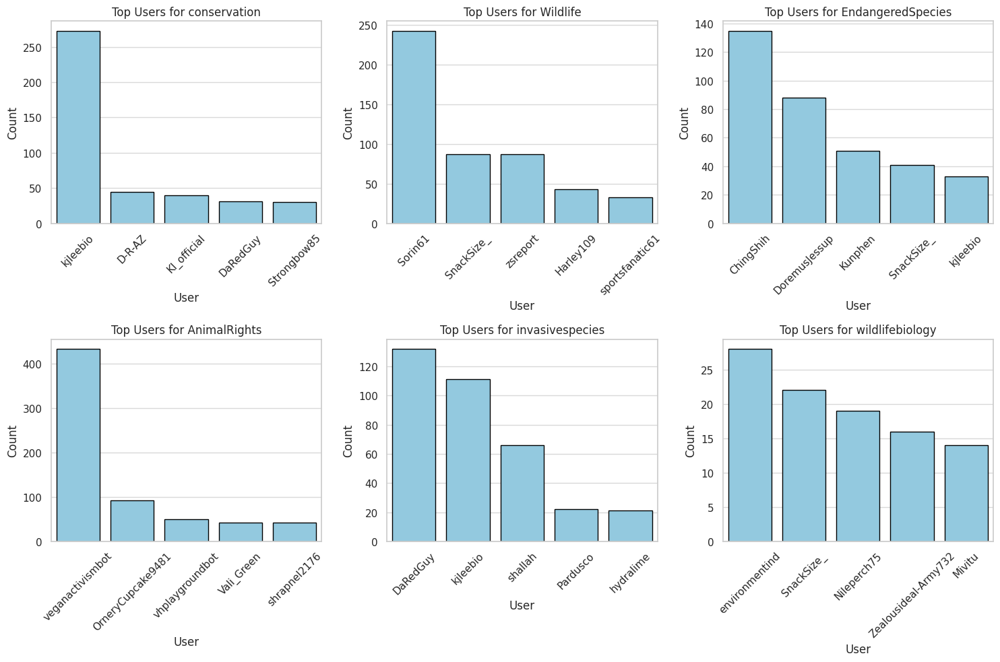

In [188]:
# Top author from each subreddit by posts count
subreddits = df['subreddit'].unique()

# Set up subplots in a 2x3 grid
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))

# Flatten the axes for easier iteration
axes = axes.flatten()

# Iterate through each subplot and each subreddit
for i, (ax, subreddit) in enumerate(zip(axes, subreddits)):
    # Get the top 5 users for the current subreddit
    top_users = df[df['subreddit'] == subreddit]['author'].value_counts().nlargest(5)

    # Plotting the bar chart for the current subreddit
    sns.barplot(x=top_users.index, y=top_users.values, ax=ax, color='skyblue', edgecolor='black')
    ax.set_title(f'Top Users for {subreddit}')
    ax.set_xlabel('User')
    ax.set_ylabel('Count')
    ax.grid(axis='y', alpha=0.75)
    ax.tick_params(axis='x', rotation=45)

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()

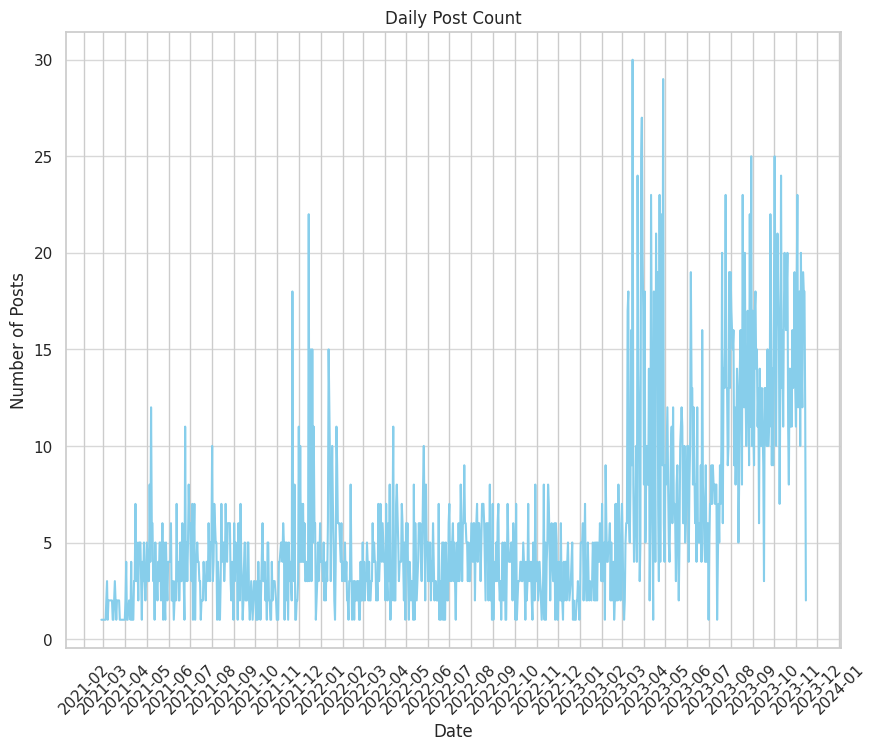

In [193]:
import matplotlib.dates as mdates

daily_post_count = df.groupby(df['created_at'].dt.date).size().reset_index(name='post_count')

plt.figure(figsize=(10, 8))
sns.lineplot(x='created_at', y='post_count', data=daily_post_count, color='skyblue')
plt.title('Daily Post Count')
plt.xlabel('Date')
plt.ylabel('Number of Posts')
plt.grid(axis='y', alpha=0.75)

# Setting the x-axis to display each month
plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

plt.xticks(rotation=45)
plt.show()

<ipython-input-190-ad57de8cc89a>:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([label.get_text() for label in ax.get_xticklabels()], rotation=45)


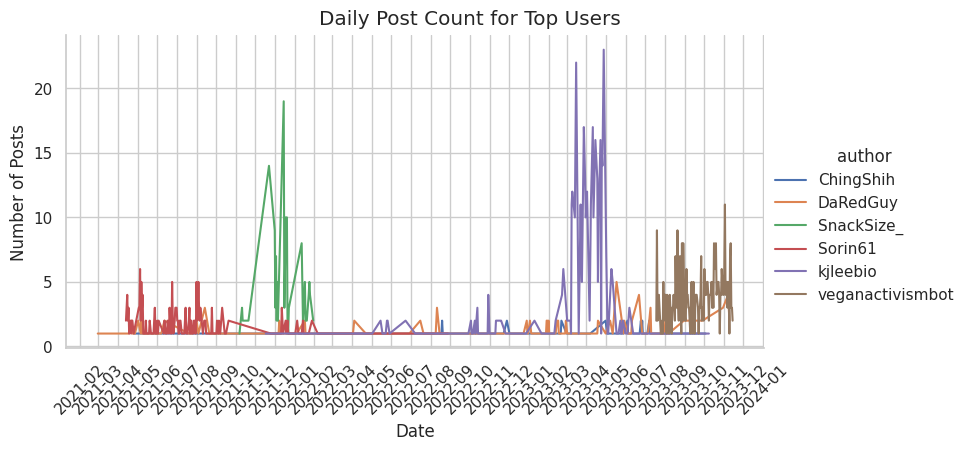

<Figure size 1600x1200 with 0 Axes>

In [190]:
top_users = df['author'].value_counts().nlargest(6).index
daily_post_count = df.groupby(['author', df['created_at'].dt.date]).size().reset_index(name='post_count')

# Create the relplot
g = sns.relplot(x='created_at', y='post_count', hue='author', kind='line', data=daily_post_count[daily_post_count['author'].isin(top_users)], aspect=2, height=4)

# Set titles and labels
g.fig.suptitle('Daily Post Count for Top Users', y=1.02)
g.set_xlabels('Date')
g.set_ylabels('Number of Posts')

for ax in g.axes.flat:
    ax.xaxis.set_major_locator(mdates.MonthLocator())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
    ax.set_xticklabels([label.get_text() for label in ax.get_xticklabels()], rotation=45)

# Show the plot
plt.figure(figsize=(16, 12))
plt.show()

<ipython-input-191-0f1f79b21269>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45)


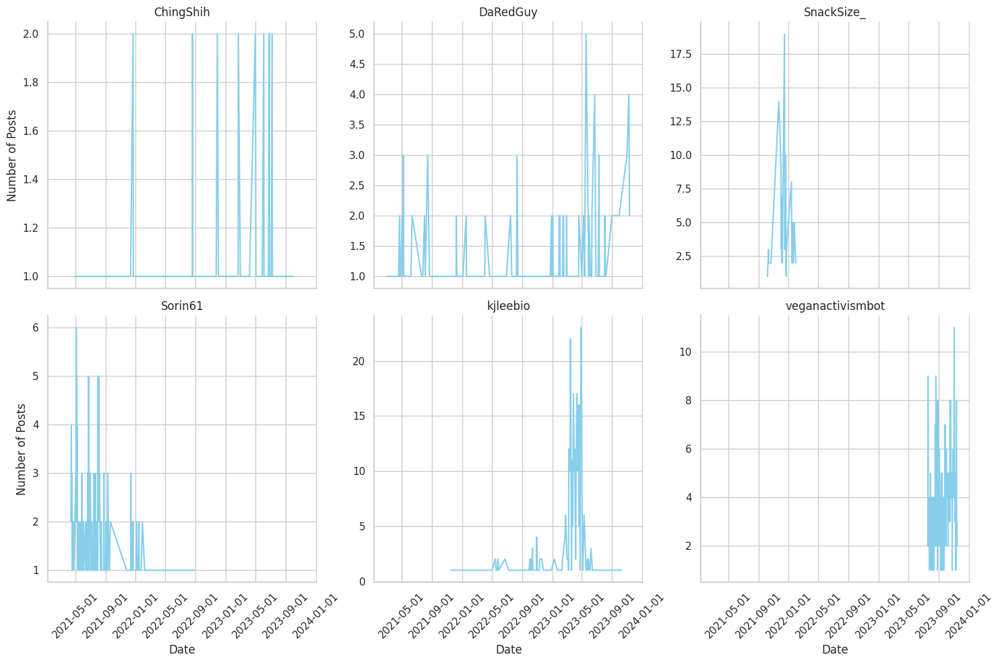

In [191]:
top_users = df['author'].value_counts().nlargest(6).index
daily_post_count = df.groupby(['author', df['created_at'].dt.date]).size().reset_index(name='post_count')
g = sns.FacetGrid(daily_post_count[daily_post_count['author'].isin(top_users)], col='author', col_wrap=3, height=5, sharey=False)
g.map(sns.lineplot, 'created_at', 'post_count', color='skyblue')

# Set titles and labels
g.set_titles(col_template="{col_name}")
g.set_axis_labels('Date', 'Number of Posts')

# Adjust the rotation and format of the x-axis labels
for ax in g.axes.flatten():
    ax.xaxis.set_major_locator(mdates.AutoDateLocator())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

# Adjust spacing
plt.tight_layout()

# Show the plot
plt.show()

# Sentimental Analysis

In [ ]:
# Sentimental Analysis
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer as SIA
from textblob import TextBlob
from nltk.corpus import stopwords
from wordcloud import WordCloud

nltk.download('vader_lexicon')
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
sentimental_df = pd.DataFrame(df[['title', 'author']], columns=['title', 'author'])  #Since I will be using author, i will put it there
sentimental_df.head()

,title,author
0,EPA sued over pesticide-coated seeds’ ‘devasta...,DaRedGuy
1,Researchers explore techniques to successfully...,kjleebio
2,Online appeal launched to help Welsh seagrass ...,kjleebio
3,Vodacom South Africa and WWF recommit to ocean...,kjleebio
4,'New kind of park': Ecological wonderland plan...,kjleebio


In [ ]:
# Clear useless word out from dataset

# Text preprocessing
stop_words = set(stopwords.words('english'))
def preprocess_text(text):
    words = nltk.word_tokenize(text)
    words = [word.lower() for word in words if word.isalnum() and word.lower() not in stop_words]
    return ' '.join(words)

sentimental_df['title'] = sentimental_df['title'].apply(preprocess_text)
sentimental_df.head()

,title,author
0,epa sued seeds devastating impacts us wildlife,DaRedGuy
1,researchers explore techniques successfully re...,kjleebio
2,online appeal launched help welsh seagrass pro...,kjleebio
3,vodacom south africa wwf recommit ocean conser...,kjleebio
4,kind park ecological wonderland plans revealed,kjleebio


In [ ]:
def analyze_sentiment(text):
    analysis = TextBlob(text)
    return analysis.sentiment.polarity

sentimental_df['sentiment_score'] = sentimental_df['title'].apply(analyze_sentiment)
sentimental_df

,title,author,sentiment_score
0,epa sued seeds devastating impacts us wildlife,DaRedGuy,-1.000000
1,researchers explore techniques successfully re...,kjleebio,0.350000
2,online appeal launched help welsh seagrass pro...,kjleebio,0.000000
3,vodacom south africa wwf recommit ocean conser...,kjleebio,0.000000
4,kind park ecological wonderland plans revealed,kjleebio,0.500000
...,...,...,...
5789,illegal wildlife trade posing ecological threa...,environmentind,-0.050000
5790,survey taxonomy wildlife biology,fishfacedmf,0.000000
5791,kind related masters,coffinpoppies,0.300000
5792,job market,HallowedSeeker,0.000000


In [ ]:
sia = SIA()
results = []

for index, row in sentimental_df.iterrows():
    pol_score = sia.polarity_scores(row['title'])
    sentimental_df.at[index, 'neg'] = pol_score['neg']
    sentimental_df.at[index, 'neu'] = pol_score['neu']
    sentimental_df.at[index, 'pos'] = pol_score['pos']
    sentimental_df.at[index, 'compound'] = pol_score['compound']


In [ ]:
sentimental_df.head()

,title,author,sentiment_score,neg,neu,pos,compound
0,epa sued seeds devastating impacts us wildlife,DaRedGuy,-1.00,0.417,0.583,0.000,-0.6486
1,researchers explore techniques successfully re...,kjleebio,0.35,0.000,0.686,0.314,0.4939
2,online appeal launched help welsh seagrass pro...,kjleebio,0.00,0.000,0.435,0.565,0.6705
3,vodacom south africa wwf recommit ocean conser...,kjleebio,0.00,0.000,1.000,0.000,0.0000
4,kind park ecological wonderland plans revealed,kjleebio,0.50,0.000,0.595,0.405,0.5267


In [ ]:
# Labeling the title by defining a threshold
# 1 positive
# -1 negative
# 0 neutral
sentimental_df['label'] = 0
sentimental_df.loc[sentimental_df['compound'] > 0.2, 'label'] = 1
sentimental_df.loc[sentimental_df['compound'] < -0.2, 'label'] = -1
sentimental_df.head()

,title,author,sentiment_score,neg,neu,pos,compound,label
0,epa sued seeds devastating impacts us wildlife,DaRedGuy,-1.00,0.417,0.583,0.000,-0.6486,-1
1,researchers explore techniques successfully re...,kjleebio,0.35,0.000,0.686,0.314,0.4939,1
2,online appeal launched help welsh seagrass pro...,kjleebio,0.00,0.000,0.435,0.565,0.6705,1
3,vodacom south africa wwf recommit ocean conser...,kjleebio,0.00,0.000,1.000,0.000,0.0000,0
4,kind park ecological wonderland plans revealed,kjleebio,0.50,0.000,0.595,0.405,0.5267,1


In [ ]:
sentimental_df = sentimental_df[['title', 'author', 'label']]
sentimental_df.head()

,title,author,label
0,epa sued seeds devastating impacts us wildlife,DaRedGuy,-1
1,researchers explore techniques successfully re...,kjleebio,1
2,online appeal launched help welsh seagrass pro...,kjleebio,1
3,vodacom south africa wwf recommit ocean conser...,kjleebio,0
4,kind park ecological wonderland plans revealed,kjleebio,1


In [ ]:
sentimental_df.to_csv('wildlife_conservation_labels.csv', encoding='utf-8', index=False)

In [ ]:
from nltk.corpus import stopwords
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.decomposition import LatentDirichletAllocation
from gensim.models import Word2Vec
from nltk.sentiment import SentimentIntensityAnalyzer

nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
#Load labeled data
label_df = pd.read_csv('wildlife_conservation_labels.csv')
label_df.head()

,title,author,label
0,epa sued seeds devastating impacts us wildlife,DaRedGuy,-1
1,researchers explore techniques successfully re...,kjleebio,1
2,online appeal launched help welsh seagrass pro...,kjleebio,1
3,vodacom south africa wwf recommit ocean conser...,kjleebio,0
4,kind park ecological wonderland plans revealed,kjleebio,1


In [ ]:
label_df.isna().sum()

title     4
author    0
label     0
dtype: int64

In [ ]:
sen_df = label_df.dropna()

Machine Learning Model:
Accuracy: 0.7971781305114638
Classification Report:
               precision    recall  f1-score   support

          -1       0.86      0.66      0.75       273
           0       0.75      0.91      0.82       558
           1       0.89      0.71      0.79       303

    accuracy                           0.80      1134
   macro avg       0.83      0.76      0.79      1134
weighted avg       0.81      0.80      0.79      1134


Topic Modeling (LDA):
Topic 1: wildlife, endangered, species, animal, animals
Topic 2: endangered, needed, new, wildlife, help
Topic 3: invasive, species, new, conservation, wildlife

Word Embeddings (Word2Vec):
[('new', 0.9741929769515991), ('animal', 0.9709677696228027), ('found', 0.9705909490585327), ('one', 0.9697113633155823), ('conservation', 0.9680952429771423)]


<ipython-input-40-3f141e353f34>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sen_df['emotion'] = sen_df['title'].apply(lambda x: sia.polarity_scores(x)['compound'])



Emotion Analysis:


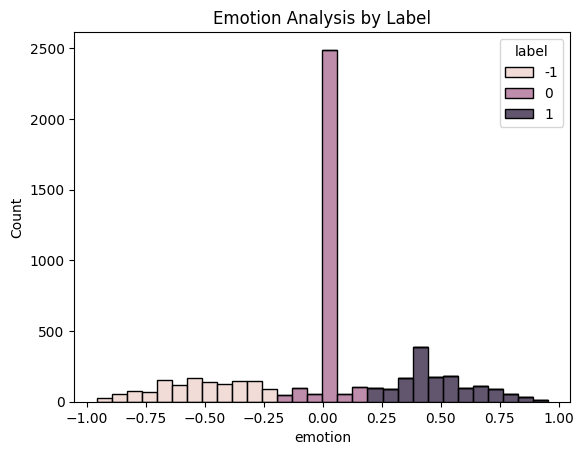

In [ ]:
# Machine Learning Models
X_train, X_test, y_train, y_test = train_test_split(sen_df['title'], sen_df['label'], test_size=0.2, random_state=42)

vectorizer = CountVectorizer()
X_train_vectorized = vectorizer.fit_transform(X_train)
X_test_vectorized = vectorizer.transform(X_test)

classifier = RandomForestClassifier(random_state=42)
classifier.fit(X_train_vectorized, y_train)

y_pred = classifier.predict(X_test_vectorized)

print("Machine Learning Model:")
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))

# Topic Modeling using Latent Dirichlet Allocation (LDA)
num_topics = 3  # You can adjust the number of topics based on your data
lda = LatentDirichletAllocation(n_components=num_topics, random_state=42)
X_topics = lda.fit_transform(X_train_vectorized)

print("\nTopic Modeling (LDA):")
for topic_idx, topic in enumerate(lda.components_):
    top_keywords_idx = topic.argsort()[-5:][::-1]
    top_keywords = [vectorizer.get_feature_names_out()[idx] for idx in top_keywords_idx]
    print(f"Topic {topic_idx + 1}: {', '.join(top_keywords)}")

# Word Embeddings using Word2Vec
sentences = [nltk.word_tokenize(title) for title in sen_df['title']]
word2vec_model = Word2Vec(sentences, vector_size=50, window=3, min_count=1, workers=4)

print("\nWord Embeddings (Word2Vec):")
print(word2vec_model.wv.most_similar('wildlife', topn=5))

# Emotion Analysis using SentimentIntensityAnalyzer
sia = SentimentIntensityAnalyzer()
sen_df['emotion'] = sen_df['title'].apply(lambda x: sia.polarity_scores(x)['compound'])

print("\nEmotion Analysis:")
sns.histplot(sen_df, x='emotion', hue='label', multiple='stack', bins=30)
plt.title('Emotion Analysis by Label')
plt.show()

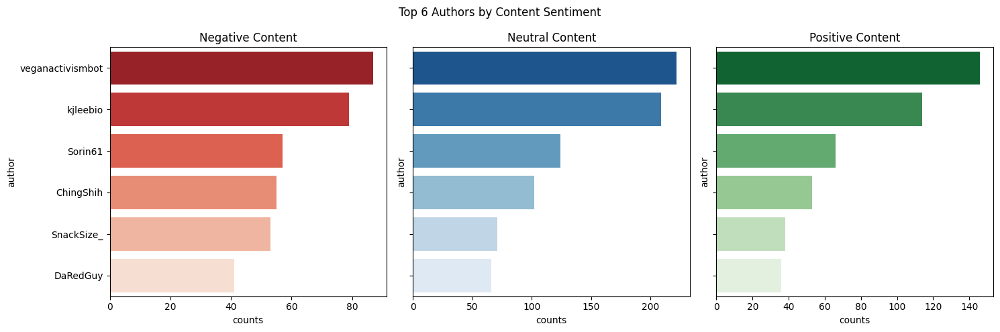

In [ ]:
# Visualization of Content
# Separate dataframes for each label category
def get_top_authors_for_label(label, n=6):
    filtered_df = sen_df[sen_df['label'] == label]
    return filtered_df['author'].value_counts().head(n).reset_index().rename(columns={'index': 'author', 'author': 'counts'})

# Get top authors for each sentiment
neg_authors = get_top_authors_for_label(-1)
neu_authors = get_top_authors_for_label(0)
pos_authors = get_top_authors_for_label(1)

# Plotting
fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=True)
fig.suptitle('Top 6 Authors by Content Sentiment')

sns.barplot(x='counts', y='author', data=neg_authors, ax=axes[0], palette='Reds_r')
axes[0].set_title('Negative Content')

sns.barplot(x='counts', y='author', data=neu_authors, ax=axes[1], palette='Blues_r')
axes[1].set_title('Neutral Content')

sns.barplot(x='counts', y='author', data=pos_authors, ax=axes[2], palette='Greens_r')
axes[2].set_title('Positive Content')

plt.tight_layout()
plt.show()

In [ ]:
# Word Cloud to generated the word that might be useful for our network
# Network by Words

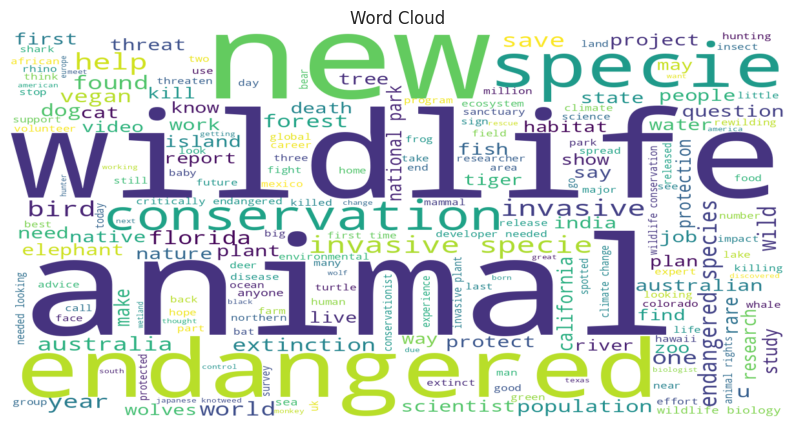

In [ ]:
# Word Cloud
from wordcloud import WordCloud

text = ' '.join(sen_df['title'].astype(str))
text = ''.join(e for e in text if (e.isalpha() or e.isspace()))

# Generate a word cloud using WordCloud
wordcloud = WordCloud(width=1200, height=800, background_color='white').generate(text)

# Use Seaborn for plotting
plt.figure(figsize=(10, 5))
sns.set(style="whitegrid")  # Set Seaborn style

# Display the word cloud on the Seaborn plot
plt.imshow(wordcloud, interpolation='bilinear', aspect='auto')
plt.axis('off')
plt.title('Word Cloud')

# Show the plot
plt.show()

In [ ]:
common_words = wordcloud.words_

# Sort the dictionary by frequency in descending order
sorted_words = sorted(common_words.items(), key=lambda x: x[1], reverse=True)

# Get the top N words (adjust N as needed)
top_words = sorted_words[0:20]  # Adjust the number (10) to get more or fewer words

# Print the top words and their frequencies
for word, frequency in top_words:
    print(f'{word}: {frequency}')

animal: 1.0
wildlife: 0.8482142857142857
new: 0.8303571428571429
endangered: 0.7321428571428571
specie: 0.6339285714285714
conservation: 0.5744047619047619
invasive specie: 0.5654761904761905
invasive: 0.5208333333333334
help: 0.5119047619047619
bird: 0.4375
save: 0.38095238095238093
year: 0.36904761904761907
endangered species: 0.36607142857142855
found: 0.34226190476190477
world: 0.3392857142857143
wild: 0.3333333333333333
one: 0.3333333333333333
australia: 0.33035714285714285
florida: 0.32142857142857145
forest: 0.3005952380952381


In [ ]:
from collections import defaultdict
import re

author_words = defaultdict(str)
word_frequencies = defaultdict(lambda: defaultdict(int))

for index, row in sen_df.iterrows():
    author_words[row['author']] += row['title'] + ' '

for author, text in author_words.items():
    # Removing non-alphabetic characters and converting to lowercase
    text = re.sub('[^a-zA-Z\s]', '', text).lower()
    words = text.split()

    # Count word frequencies
    for word in words:
        word_frequencies[author][word] += 1

In [ ]:
author_word_list = {author: list(words.keys()) for author, words in word_frequencies.items()}
author_words_df = pd.DataFrame([(author, ', '.join(words)) for author, words in author_word_list.items()], columns=['author', 'associated_words'])

In [ ]:
author_words_df

,author,associated_words
0,DaRedGuy,"epa, sued, seeds, devastating, impacts, us, wi..."
1,kjleebio,"researchers, explore, techniques, successfully..."
2,burgerpattym,"desalination, end, global, water, shortages"
3,plutoplops,"hidden, detail, image, great, barrier, reef, o..."
4,RenaissanceLlama,"seeking, input, community, ecological, researc..."
...,...,...
1762,Swamp-Sta1ker,"wally, emotional, support, alligator, friendly"
1763,CalamityCIam,"feel, future"
1764,Irisgrower2,"resources, building, artificial, dens"
1765,HallowedSeeker,"job, market"


In [ ]:
author_words_df.to_csv('author_associated_words.csv', index=False)

# Network By Pure Reddit

In [ ]:
# Network Construction
import networkx as nx

G = nx.Graph()

G.add_nodes_from(df['author'])

edges = []

for _, row in df.iterrows():
    edges.append((row['author'], row['subreddit'], {'post_id': row['id']}))
    # edges.append((row['author'], row['subreddit'], {'post_id': row['id'], 'interaction': 'upvote', 'weight': row['score']*row['upvote_ratio']}))

G.add_edges_from(edges)
print("Number of Nodes:", G.number_of_nodes())
print("Number of Edges:", G.number_of_edges())
avg_degree = sum(dict(G.degree()).values()) / G.number_of_nodes()
print("Average Degree:", avg_degree)

# Set the layout of the graph (you can choose different layouts)
pos = nx.spring_layout(G)

# Draw the graph
plt.figure(figsize=(100, 100))
nx.draw(G, pos, with_labels=True, node_color='skyblue', node_size=100, font_size=10, font_color='black')
plt.title('Reddit User Interaction Network By Subreddit')
plt.show()

Number of Nodes: 1777
Number of Edges: 1903
Average Degree: 2.1418120427687115


In [ ]:
# Make it a bit beautiful...
G = nx.Graph()

# Adding authors and subreddits as nodes
G.add_nodes_from(df['author'], node_type='author')
G.add_nodes_from(df['subreddit'].unique(), node_type='subreddit')

# Creating edges
edges = [(row['author'], row['subreddit']) for _, row in df.iterrows()]
G.add_edges_from(edges)

# Separate the nodes by type (author, subreddit) for coloring
author_nodes = [node for node, attr in G.nodes(data=True) if attr['node_type'] == 'author']
subreddit_nodes = [node for node, attr in G.nodes(data=True) if attr['node_type'] == 'subreddit']

# Network information
print("Number of Nodes:", G.number_of_nodes())
print("Number of Edges:", G.number_of_edges())
avg_degree = sum(dict(G.degree()).values()) / G.number_of_nodes()
print("Average Degree:", avg_degree)

# Layout
pos = nx.spring_layout(G)

# Drawing the graph
plt.figure(figsize=(100, 100))
nx.draw_networkx_nodes(G, pos, nodelist=author_nodes, node_color='green', node_size=100, label='Authors')
nx.draw_networkx_nodes(G, pos, nodelist=subreddit_nodes, node_color='orange', node_size=600, label='Subreddits')
nx.draw_networkx_edges(G, pos)
nx.draw_networkx_labels(G, pos, font_size=8, font_color='white')

plt.title('Reddit User In Subreddit Network')
plt.legend()
plt.show()

Number of Nodes: 1777
Number of Edges: 1903
Average Degree: 2.1418120427687115


In [ ]:
nx.write_graphml(G, "author_in_subreddit.graphml")

In [82]:
# Let's create a subgraph with specific authors
specific_authors = ['kjleebio', 'Sorin61', 'ChingShih']  # Can replace with other author names
subgraph = G.subgraph(specific_authors)

In [83]:
# Creating a subgraph with all subreddit nodes
subreddit_nodes = [node for node, attr in G.nodes(data=True) if attr['node_type'] == 'subreddit']
subreddit_subgraph = G.subgraph(subreddit_nodes)

In [84]:
# Ego graph for a specific author or subreddit
ego_graph = nx.ego_graph(G, 'environmentind', radius=1)

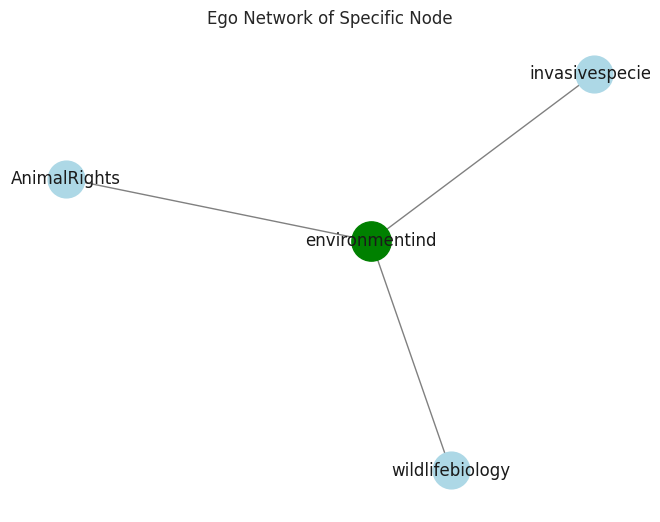

In [85]:
pos = nx.spring_layout(ego_graph)

nx.draw(ego_graph, pos, with_labels=True, node_size=700, node_color='lightblue', edge_color='gray')

nx.draw_networkx_nodes(ego_graph, pos, nodelist=['environmentind'], node_size=800, node_color='green')

plt.title('Ego Network of Specific Node')
plt.show()

In [86]:
specific_authors = ['kjleebio', 'Sorin61', 'ChingShih', 'veganactivismbot', 'DaRedGuy', 'environmentind']
combined_ego_graph = nx.Graph()
for author in specific_authors:
    eg = nx.ego_graph(G, author, radius=1)
    combined_ego_graph = nx.compose(combined_ego_graph, eg)

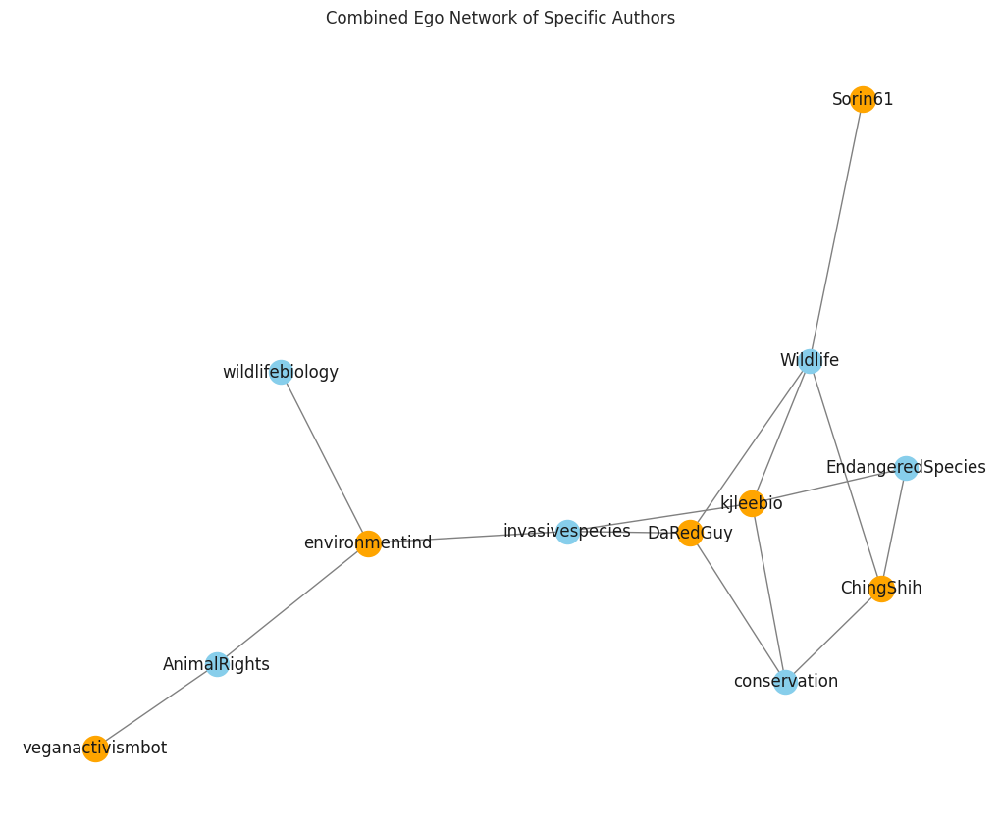

In [87]:
pos = nx.spring_layout(combined_ego_graph)
plt.figure(figsize=(10, 8))
nx.draw(combined_ego_graph, pos, with_labels=True, node_size=300, node_color='skyblue', edge_color='gray')

nx.draw_networkx_nodes(combined_ego_graph, pos, nodelist=specific_authors, node_size=350, node_color='orange')

plt.title('Combined Ego Network of Specific Authors')
plt.show()

# Network of Context and Author

In [89]:
df = pd.read_csv('author_associated_words.csv')

In [92]:
for _, row in df.iterrows():
    author = row['author']
    keywords = row['associated_words'].split()
    G.add_node(author, type='author')

    # Add nodes for keywords and edges from author to keywords
    for keyword in keywords:
        G.add_node(keyword, type='keyword')
        G.add_edge(author, keyword)

In [95]:
print("Nodes: ", G.nodes())
print("Edges: ", G.edges())

Nodes:  ['DaRedGuy', 'kjleebio', 'burgerpattym', 'plutoplops', 'RenaissanceLlama', 'Educational_Letter66', 'ecodogcow', 'bethany_mcguire', 'biodiversity_gremlin', 'TheMuseumOfScience', 'turnipmeatloaf', 'intengineering', 'Mysterious_Eye_9446', 'Mog566', 'Digimaverick', 'Oldfolksboogie', 'Strongbow85', 'Greedy-Relative-8823', 'timo348', 'RainforestProtectors', 'D-R-AZ', 'KI_official', 'Zealousideal-Army732', 'trueslicky', 'BlitheMayonnaise', 'Affectionate_Elk_608', 'nasaarset', 'Czarben', '_Beasters_', 'drak0bsidian', 'Elfgal456', 'Particular-Hedgehog7', 'Sad-Silly-666', 'Successful-Formal398', 'Johnmayer000', 'ChingShih', 'rhrifgdgdvd', 'PsychedelicScythe', 'AlasdairAlbannach', 'iamnotarobot542', 'AncientForestBC', 'More-Exchange3505', 'lefteris316', 'vnpttl', 'OutrageousOutdoorGuy', 'jflag789', 'Jojuj', 'AlexSanchezW', 'burtzev', 'StarZailing', 'mpvandenburg', 'OptimalCrew7992', 'Ornery-Honeydewer', 'qpooqpoo', 'AugustWolf22', 'BigDaddySodaPop', 'Rispy_Girl', 'iteaworld', 'FERNnews', 

In [123]:
def draw_subgraph_for_keyword(G, keyword):
    if keyword not in G:
        print(f"Keyword '{keyword}' not found in the graph.")
        return

    authors_with_keyword = [node for node in G.neighbors(keyword)]

    nodes_to_include = authors_with_keyword + [keyword]
    subgraph = G.subgraph(nodes_to_include)

    pos = nx.spring_layout(subgraph)
    plt.figure(figsize=(8,6))
    nx.draw(subgraph, pos, with_labels=True, node_size=700, node_color='lightblue', edge_color='gray')
    plt.title(f"Subgraph for keyword '{keyword}'")
    plt.show()

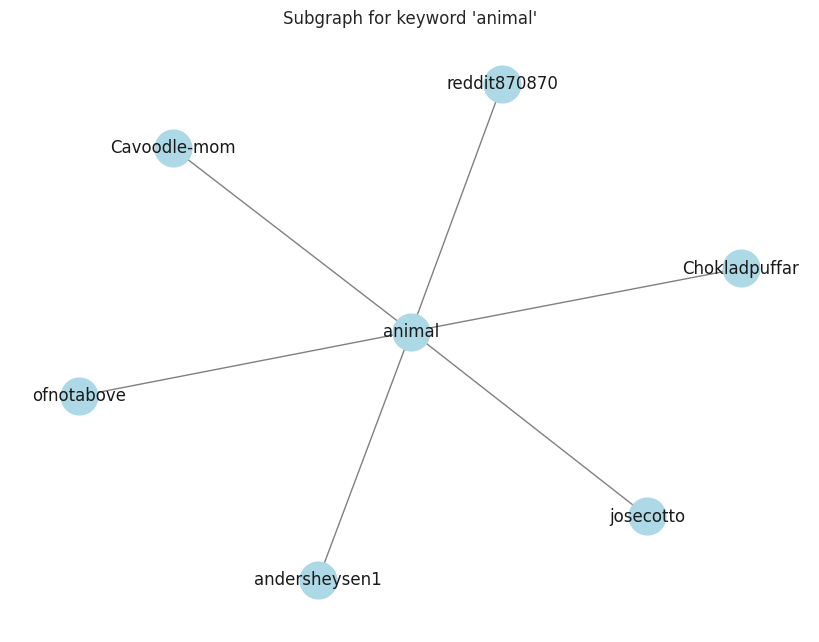

In [126]:
draw_subgraph_for_keyword(G, 'animal')

In [129]:
def draw_subgraph_for_keywords(G, keywords, save_graph=False, filename="subgraph_for_keywords.graphml"):
    authors_with_keywords = set()
    valid_keywords = set()

    for keyword in keywords:
        if keyword in G:
            valid_keywords.add(keyword)
            authors_with_keywords.update(G.neighbors(keyword))
        else:
            print(f"Keyword '{keyword}' not found in the graph.")

    if not valid_keywords:
        print("None of the keywords were found in the graph. Cannot draw subgraph.")
        return

    nodes_to_include = authors_with_keywords.union(valid_keywords)
    subgraph = G.subgraph(nodes_to_include)

    pos = nx.spring_layout(subgraph, seed=42)  # seed for reproducible layout
    plt.figure(figsize=(12, 12))
    nx.draw(subgraph, pos, with_labels=True, node_size=200, edge_color='gray',
            node_color=['purple' if node in valid_keywords else 'lightblue' for node in subgraph])
    plt.title(f"Subgraph for keywords: {', '.join(valid_keywords)}")
    plt.show()

    if save_graph:
        nx.write_graphml(subgraph, filename)
        print(f"Subgraph saved to '{filename}'")

Top 20 words from our EDA:
animal, wildlife, new, endangered, specie, conservation, invasive, specie, invasive, help, bird, save, year, endangered, species, found, world, wild, one, australia, florida, forest

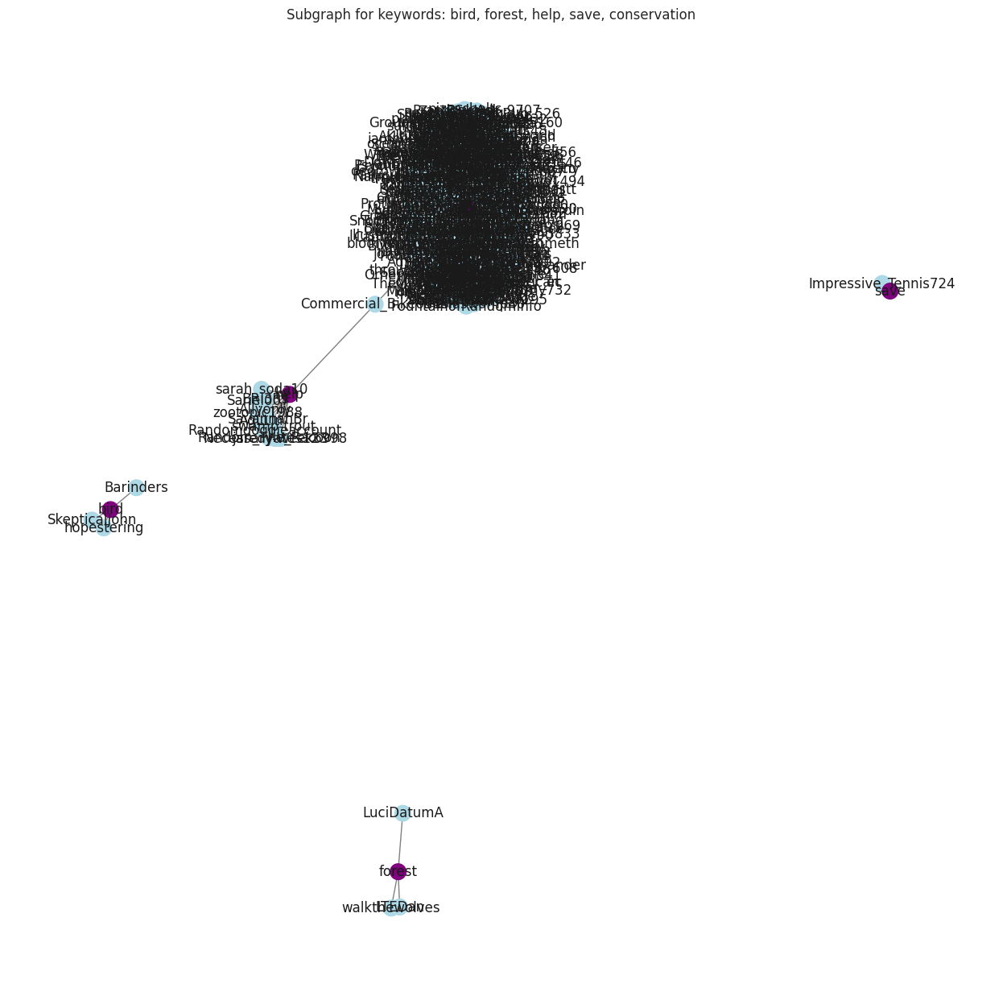

Subgraph saved to 'keywords_subgraph.graphml'


In [131]:
# We will save the file and make the graph more visualize in Cytoscape to put in our report.
draw_subgraph_for_keywords(G, ['conservation', 'help', 'bird', 'save', 'forest'], save_graph=True, filename="keywords_subgraph.graphml")

In [141]:
for node in G.nodes:
    print(f"Node: {node}")
    neighbors = list(G.neighbors(node))
    print(f"Neighbors: {neighbors}")
    # in_edges = list(G.in_edges(node)) # for Directed Graph
    # out_edges = list(G.out_edges(node)) # for Directed Graph
    # print(f"Incoming Edges: {in_edges}")
    # print(f"Outgoing Edges: {out_edges}")
    print("="*30)

Streaming output truncated to the last 5000 lines.
Neighbors: ['Writerpress']
Node: practices,
Neighbors: ['Writerpress']
Node: farm
Neighbors: ['Writerpress']
Node: rushing,
Neighbors: ['repulsive_angel']
Node: gunpoint,
Neighbors: ['repulsive_angel']
Node: police
Neighbors: ['repulsive_angel']
Node: truly,
Neighbors: ['Huge_Pay8265', 'The-Esquire']
Node: exploitation,
Neighbors: ['Huge_Pay8265']
Node: persons,
Neighbors: ['Huge_Pay8265']
Node: therefore,
Neighbors: ['Huge_Pay8265']
Node: treated
Neighbors: ['Huge_Pay8265']
Node: songbirds,
Neighbors: ['Aimee_Fleming']
Node: perish,
Neighbors: ['Aimee_Fleming']
Node: crashing,
Neighbors: ['Aimee_Fleming']
Node: chicago,
Neighbors: ['Aimee_Fleming']
Node: exhibition,
Neighbors: ['Aimee_Fleming']
Node: hall
Neighbors: ['Aimee_Fleming']
Node: depot,
Neighbors: ['SealLionGar', 'latigresita']
Node: mulberry,
Neighbors: ['SealLionGar', 'Deep_Internet2828']
Node: isnt,
Neighbors: ['SealLionGar']
Node: lake
Neighbors: ['SealLionGar', 'skullyi

In [142]:
density = nx.density(G)
print(f"Graph Density: {density}")

Graph Density: 0.0004755877455443743


In [145]:
fell_whitehead_path = nx.shortest_path(G, source="kjleebio", target="Sorin61")
print("Shortest path between Fell and Whitehead:", fell_whitehead_path)

Shortest path between Fell and Whitehead: ['kjleebio', 'Wildlife', 'Sorin61']


In [146]:
#inspect nodes and edges
print(G.nodes())
print(G.edges())

['DaRedGuy', 'kjleebio', 'burgerpattym', 'plutoplops', 'RenaissanceLlama', 'Educational_Letter66', 'ecodogcow', 'bethany_mcguire', 'biodiversity_gremlin', 'TheMuseumOfScience', 'turnipmeatloaf', 'intengineering', 'Mysterious_Eye_9446', 'Mog566', 'Digimaverick', 'Oldfolksboogie', 'Strongbow85', 'Greedy-Relative-8823', 'timo348', 'RainforestProtectors', 'D-R-AZ', 'KI_official', 'Zealousideal-Army732', 'trueslicky', 'BlitheMayonnaise', 'Affectionate_Elk_608', 'nasaarset', 'Czarben', '_Beasters_', 'drak0bsidian', 'Elfgal456', 'Particular-Hedgehog7', 'Sad-Silly-666', 'Successful-Formal398', 'Johnmayer000', 'ChingShih', 'rhrifgdgdvd', 'PsychedelicScythe', 'AlasdairAlbannach', 'iamnotarobot542', 'AncientForestBC', 'More-Exchange3505', 'lefteris316', 'vnpttl', 'OutrageousOutdoorGuy', 'jflag789', 'Jojuj', 'AlexSanchezW', 'burtzev', 'StarZailing', 'mpvandenburg', 'OptimalCrew7992', 'Ornery-Honeydewer', 'qpooqpoo', 'AugustWolf22', 'BigDaddySodaPop', 'Rispy_Girl', 'iteaworld', 'FERNnews', 'idspisp

In [147]:
# If Graph has more than one component, this will return False:
print(nx.is_connected(G))

# Next, use nx.connected_components to get the list of components,
# then use the max() command to find the largest one:
components = nx.connected_components(G)
largest_component = max(components, key=len)

# Create a "subgraph" of just the largest component
# Then calculate the diameter of the subgraph, just like you did with density.

subgraph = G.subgraph(largest_component)
diameter = nx.diameter(subgraph)
print("Network diameter of largest component:", diameter)

True
Network diameter of largest component: 6


In [149]:
triadic_closure = nx.transitivity(G)
print("Triadic closure:", triadic_closure)

Triadic closure: 0


In [155]:
degree_dict = dict(G.degree(G.nodes()))
nx.set_node_attributes(G, degree_dict, 'degree')
print(G.nodes['kjleebio'])

{'node_type': 'author', 'type': 'author', 'degree': 1578}


In [156]:
from operator import itemgetter
from networkx.algorithms import community

sorted_degree = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by degree:")
for d in sorted_degree[:20]:
    print(d)

Top 20 nodes by degree:
('kjleebio', 1578)
('veganactivismbot', 1465)
('Sorin61', 1172)
('DaRedGuy', 1100)
('ChingShih', 934)
('DoremusJessup', 853)
('SnackSize_', 664)
('wildlifebiology', 586)
('drak0bsidian', 516)
('zsreport', 468)
('Strongbow85', 432)
('OrneryCupcake9481', 424)
('shallah', 415)
('invasivespecies', 401)
('Kunphen', 373)
('sportsfanatic61', 358)
('808gecko808', 325)
('honolulu_oahu_mod', 309)
('conservation', 302)
('D-R-AZ', 295)


In [157]:
betweenness_dict = nx.betweenness_centrality(G) # Run betweenness centrality
eigenvector_dict = nx.eigenvector_centrality(G, max_iter=5000) # Run eigenvector centrality

# Assign each to an attribute in your network
nx.set_node_attributes(G, betweenness_dict, 'betweenness')
nx.set_node_attributes(G, eigenvector_dict, 'eigenvector')

In [158]:
sorted_betweenness = sorted(betweenness_dict.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by betweenness centrality:")
for b in sorted_betweenness[:20]:
    print(b)

Top 20 nodes by betweenness centrality:
('kjleebio', 0.14689988973497706)
('veganactivismbot', 0.14559921069771964)
('Sorin61', 0.09609189614068496)
('DaRedGuy', 0.09184689208931193)
('wildlifebiology', 0.07802427232706402)
('ChingShih', 0.07008467245592767)
('invasivespecies', 0.06218922459757959)
('DoremusJessup', 0.05889859060391604)
('SnackSize_', 0.04521067167237083)
('conservation', 0.04123177000261089)
('drak0bsidian', 0.03784502699303181)
('wildlife,', 0.034608857635687794)
('OrneryCupcake9481', 0.029434422191004162)
('EndangeredSpecies', 0.026982895890654973)
('Strongbow85', 0.025875690582638933)
('zsreport', 0.02428762166953669)
('AnimalRights', 0.022850272126659233)
('shallah', 0.02266410524845497)
('species,', 0.02220688300197531)
('animal,', 0.021485348929442104)
